In [414]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import robotdatapy as rdp # 1.0.3
import scipy as sp
import matplotlib as mpl

# plt.style.use('/home/masonbp/computer/python/matplotlib/publication.mplstyle')
SAVE = True
QUICK = True
ADD_ANNOTATIONS = False

# quicker
# if QUICK:
#     num_pcs = 100
#     num_markers = 500
# else:
#     num_pcs = 3000
#     num_markers = 4000

num_pcs = 30
num_markers = 50000

In [415]:
def get_pc(bag_path, topic, child_frame):
    pcd = rdp.data.PointCloudData.from_bag(
        path=bag_path,
        topic=topic,
    )

    marker_data = rdp.data.GeneralData.from_bag(
        path=bag_path,
        topic="/PX03/state",
        custom_msg_types=["dynus_interfaces/msg/State"],
        custom_msg_paths=["/home/kkondo/code/dynus_ws/src/dynus_interfaces/msg/State.msg"],
        ros_distro='humble',
        time_tol=30.0,
        causal=False
    )

    pc_frame = pcd.msg_header(pcd.t0).frame_id
    print("pc_frame:", pc_frame)

    pd = rdp.data.PoseData.from_bag_tf(
        bag_path,
        parent_frame="/PX03/init_pose",
        child_frame=child_frame,
        time_tol=30.0
    )
    T_map_init_pose = rdp.data.PoseData.any_static_tf_from_bag(bag_path, 'map', 'PX03/init_pose')
    pd.T_premultiply = T_map_init_pose

    # Robust point cloud extraction at pcd.tf
    pc = pcd.pointcloud(pcd.tf).get_xyz()
    # if not isinstance(vecs, np.ndarray) or vecs.ndim != 2 or vecs.shape[0] == 0 or vecs.shape[1] != 3:
    #     print(f"[Warning] Empty or invalid point cloud at t = {pcd.tf}. Skipping transform.")
    #     pc = np.zeros((0, 3))
    # else:
    #     pc = rdp.transform.transform(pd.pose(pcd.tf), vecs)

    return pc, pcd, pd, marker_data

def apply_transform(points):
    T_side_view = rdp.transform.xyz_rpy_to_transform([0., 0., 0.], [-85., -0., 0.], degrees=True) @ \
        rdp.transform.xyz_rpy_to_transform([0., 0., 0.,], [0., 0., 80.], degrees=True)
    # T_side_view = np.eye(4)

    # degrees to rotation matrix
    roll = 180
    pitch = 0
    yaw = 0

    rotation_matrix = sp.spatial.transform.Rotation.from_euler('xyz', [roll, pitch, yaw], degrees=True).as_matrix()
    T_world_cam = np.array([
        [1., 0., 0., 60.,],
        [0., -1., 0., 0.,],
        [0., 0., -1., 175.,],
        [0., 0., 0., 1.,]
    ])

    K = np.array([[300, 0., 0.], [0., 300, 0.], [0., 0., 1.]])

    points_cam = rdp.transform.transform(np.linalg.inv(T_world_cam) @ T_side_view, points)
    points_cam = points_cam[points_cam[:,2] > 0.1]
    points_side_view = rdp.camera.xyz_2_pixel(points_cam, K)
    return points_side_view

def biased_times(t0, tf, n, peaks, base=1e-3, oversample=4096, include_endpoints=True):
    """
    Nonuniform samples in [t0, tf], concentrating around given peaks.

    peaks: list of (t_center, sigma_seconds, weight)
           - t_center: time (same units as t0/tf)
           - sigma_seconds: how wide the concentration is
           - weight: how strong the bias is (>=0)
    base: small baseline so density never hits zero
    """
    assert tf > t0 and n >= 2, "bad range or n"
    L = tf - t0

    # Work in normalized u in [0,1]
    u = np.linspace(0.0, 1.0, oversample)
    pdf = np.full_like(u, base)

    for (tc, sigma, w) in peaks:
        # normalize center and width into u-space
        uc = (tc - t0) / L
        sig_u = max(sigma / L, 1e-6)
        # add a Gaussian bump
        pdf += w * np.exp(-0.5 * ((u - uc) / sig_u) ** 2)

    # Build CDF and invert it to get a warp g: [0,1]->[0,1]
    cdf = np.cumsum(pdf)
    cdf = (cdf - cdf[0]) / (cdf[-1] - cdf[0])

    # target uniform levels
    levels = np.linspace(0.0, 1.0, n)
    g = np.interp(levels, cdf, u)
    t = t0 + g * L

    if include_endpoints:
        t[0], t[-1] = t0, tf

    return t

def plot_pc(pc, pcd, pd, marker_data, bag_path, figure_name, max_vel, use_uniform_times=False, peak_time = 44.0):
    import matplotlib.pyplot as plt
    plt.style.use('dark_background')
    
    if use_uniform_times:
        # uniform times
        t = np.linspace(pcd.t0, pcd.tf, num_pcs)
    else:
        # biased times
        print(f"[Info] Generating {num_pcs} point clouds between t={pcd.t0} and t={pcd.tf}")
        t_peak = pcd.t0 + peak_time   # seconds
        t = biased_times(pcd.t0, pcd.tf, num_pcs, peaks=[(t_peak, 6.0, 3.0)])   # weight↑ => denser near peak


    pcs = []
    for ti in t:
        vecs = pcd.pointcloud(ti).get_xyz()
        if vecs.ndim != 2 or vecs.shape[0] == 0 or vecs.shape[1] != 3:
            print(f"[Warning] Skipping invalid point cloud at t = {ti}. Shape = {vecs.shape}")
            continue
        pc = vecs
        # pc = rdp.transform.transform(pd.pose(ti), vecs)
        pcs.append(pc)

    # Create figure and axis
    fig, ax = plt.subplots(figsize=(10, 10), dpi=500)

    if len(pcs) == 0:
        print("[Warning] No valid point clouds found. Skipping point cloud plot.")
        pc = np.zeros((0, 3))  # Fallback
        ax.text(0.5, 0.5, 'No valid point cloud data', transform=ax.transAxes,
                ha='center', va='center', color='white', fontsize=16)
    else:
        pc = np.vstack(pcs)
        ax.plot(pc[:, 0], pc[:, 1], '.', markersize=8.0, alpha=0.02, color='xkcd:white', markeredgecolor='none')

        # --- Compute and add a 10 m scale bar ---
        # x_min, x_max = np.min(pc[:, 0]), np.max(pc[:, 0])
        # y_min, y_max = np.min(pc[:, 1]), np.max(pc[:, 1])
        # print("x_min, x_max, y_min, y_max:", x_min, x_max, y_min, y_max)

        # x_pad = 0.05 * (x_max - x_min)
        # y_pad = 0.05 * (y_max - y_min)
        # x_scale_start = x_min + x_pad - 30.0
        # x_scale_end = x_scale_start + 10.0  # 10 meters
        # y_scale = y_max - y_pad + 20.0

        # ax.plot([x_scale_start, x_scale_end], [y_scale, y_scale], color='white', linewidth=1.5)
        # ax.plot([x_scale_start, x_scale_start], [y_scale - 0.5, y_scale + 0.5], color='white', linewidth=0.5)
        # ax.plot([x_scale_end, x_scale_end], [y_scale - 0.5, y_scale + 0.5], color='white', linewidth=0.5)
        # ax.text(x_scale_start, y_scale - 4.5, '10 m', color='white', fontsize=16)

    # --- Plot markers ---
    marker_xyz = []
    marker_colors = []
    for ti in np.linspace(marker_data.t0, marker_data.tf, num_markers):
        position_ros = marker_data.data(ti).pos
        mi = np.array([position_ros.x, position_ros.y, position_ros.z])
        # marker_xyz.append(rdp.transform.transform(pd.pose(ti), mi))
        marker_xyz.append(rdp.transform.transform(pd.pose(pd.t0), mi))

        velocity_ros = marker_data.data(ti).vel
        vel = np.linalg.norm(np.array([velocity_ros.x, velocity_ros.y, velocity_ros.z]))
        vel = np.clip(vel, 0.0, max_vel)
        
        norm = mpl.colors.Normalize(vmin=0.0, vmax=max_vel)
        cmap = mpl.colormaps['rainbow']
        rgba = cmap(norm(vel))             # (r,g,b,a) in [0,1]
        marker_colors.append([rgba[0], rgba[1], rgba[2]])
    marker_xyz = np.array(marker_xyz)
    marker_colors = np.array(marker_colors)

    for i in range(marker_xyz.shape[0]):
        ax.plot(marker_xyz[i, 0], marker_xyz[i, 1], '.', markersize=3.0, alpha=1.0, color=marker_colors[i])

    # --- Annotations ---
    if ADD_ANNOTATIONS and len(marker_xyz) > 0:
        markersize = 15.0
        bbox_props = dict(facecolor='white', boxstyle='pad=0.1')
        ax.plot([marker_xyz[0, 0]], [marker_xyz[0, 1]], '.', markersize=markersize, color='xkcd:red')
        ax.plot([marker_xyz[-1, 0]], [marker_xyz[-1, 1]], '.', markersize=markersize, color='xkcd:blue')
        ax.text(marker_xyz[0, 0] - 30.0, marker_xyz[0, 1] - 1, 'Start', color='red', fontsize=16, bbox=bbox_props)
        ax.text(marker_xyz[-1, 0] + 5.0, marker_xyz[-1, 1] - 1, 'Goal', color='blue', fontsize=16, bbox=bbox_props)

    ax.set_aspect('equal')
    ax.axis('off')

    if SAVE:
        folder_path = bag_path[:bag_path.rfind('/')]
        plt.savefig(folder_path + figure_name, bbox_inches='tight')

    return pc, marker_xyz, marker_colors

def plot_with_angle(pc, marker_xyz, marker_colors, bag_path, figure_name):
    fig, ax = plt.subplots(figsize=(10, 10), dpi=500)

    # Apply side view transform if point cloud is not empty
    if pc.shape[0] > 0:
        pc_side_view = apply_transform(pc)
        ax.plot(pc_side_view[:, 0], -pc_side_view[:, 1], '.', markersize=0.2, alpha=0.2, color='xkcd:white')
    else:
        print("[Warning] No point cloud data for side view. Skipping point cloud plot.")
        ax.text(0.5, 0.5, 'No point cloud', transform=ax.transAxes,
                ha='center', va='center', color='white', fontsize=16)

    # Apply side view transform to marker data if available
    if marker_xyz.shape[0] > 0:
        marker_xyz_side_view = apply_transform(marker_xyz)

        for i in range(marker_xyz_side_view.shape[0]):
            ax.plot(marker_xyz_side_view[i, 0], -marker_xyz_side_view[i, 1], '.',
                    markersize=1.0, alpha=1.0, color=marker_colors[i])

        if ADD_ANNOTATIONS:
            markersize = 10.0
            bbox = dict(facecolor='white', boxstyle='round,pad=0.1')
            # Plot start and goal markers
            ax.plot([marker_xyz_side_view[0, 0]], [-marker_xyz_side_view[0, 1]], '.', markersize=markersize, color='xkcd:red')
            ax.plot([marker_xyz_side_view[-1, 0]], [-marker_xyz_side_view[-1, 1]], '.', markersize=markersize, color='xkcd:blue')
            # Add labels
            ax.text(marker_xyz_side_view[0, 0] - 2, -marker_xyz_side_view[0, 1] + 3,
                    'Start', color='red', fontsize=16, bbox=bbox)
            ax.text(marker_xyz_side_view[-1, 0] - 3, -marker_xyz_side_view[-1, 1] - 5,
                    'Goal', color='blue', fontsize=16, bbox=bbox)
    else:
        print("[Warning] No marker data for side view.")

    ax.set_aspect('equal')
    ax.axis('off')

    if SAVE:
        folder_path = bag_path[:bag_path.rfind('/')]
        plt.savefig(folder_path + figure_name, bbox_inches='tight')


pc_frame: map


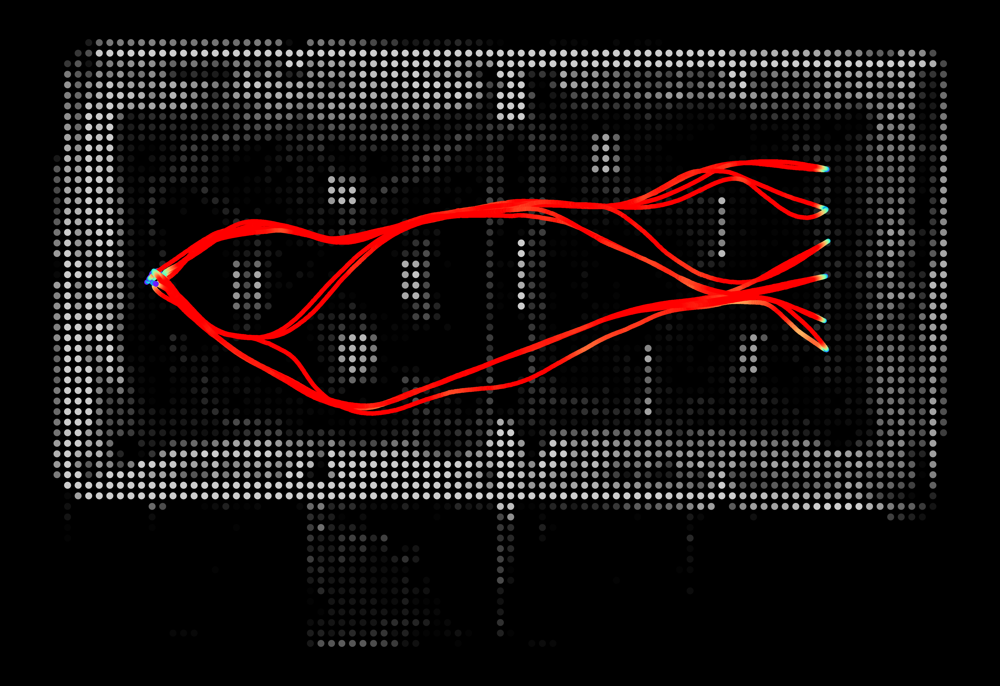

In [418]:
# plot the point cloud data
# topic = "/PX03/mid360_PointCloud2"
topic = "/PX03/static_grid_topic"
test_num = 2

bag_path = f"/media/kkondo/T7/MIGHTY/test{test_num}/rosbag2_2025_10_10-12_23_17"
pc, pcd, pd, marker_data = get_pc(bag_path, topic, child_frame="/PX03/base_link")

paper_path = "/home/kkondo/paper_writing/mighty_paper/mighty_paper/figures/hw/"
pc, marker_xyz, marker_colors = plot_pc(pc, pcd, pd, marker_data, paper_path, f"/test{test_num}/hw_test{test_num}_overhead_pc.png", max_vel = 1.0, use_uniform_times=True)
# plot_with_angle(pc, marker_xyz, marker_colors, paper_path, f"/hw_test{test_num}_side_view_pc.png")

pc_frame: map


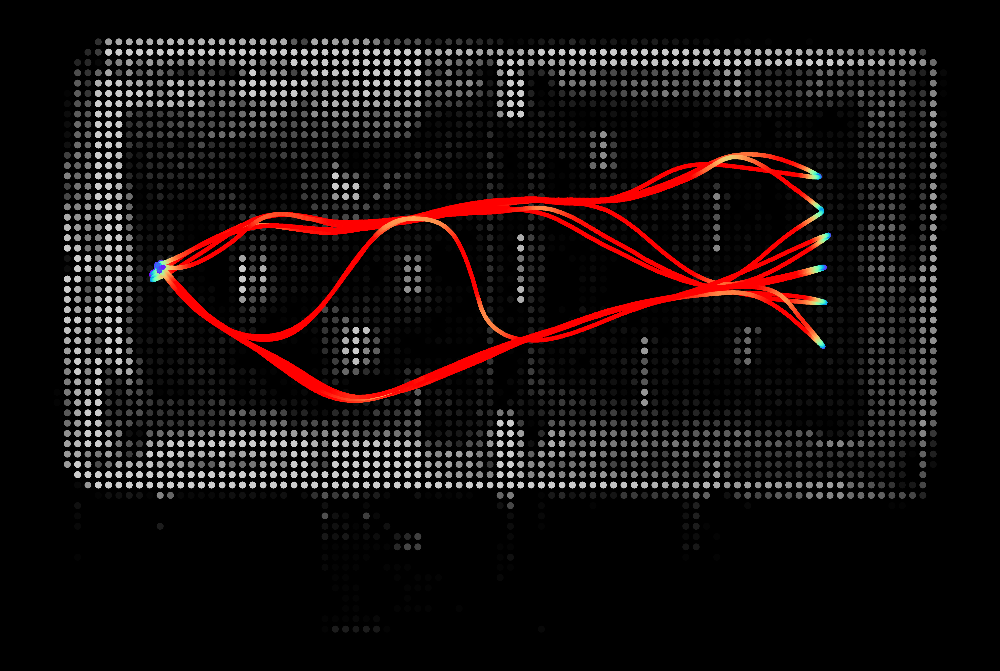

In [419]:
# plot the point cloud data
# topic = "/PX03/mid360_PointCloud2"
topic = "/PX03/static_grid_topic"
test_num = 3

bag_path = f"/media/kkondo/T7/MIGHTY/test{test_num}/rosbag2_2025_10_10-13_25_29"
pc, pcd, pd, marker_data = get_pc(bag_path, topic, child_frame="/PX03/base_link")

paper_path = "/home/kkondo/paper_writing/mighty_paper/mighty_paper/figures/hw/"
pc, marker_xyz, marker_colors = plot_pc(pc, pcd, pd, marker_data, paper_path, f"/test{test_num}/hw_test{test_num}_overhead_pc.png", max_vel = 2.0, use_uniform_times=True)
# plot_with_angle(pc, marker_xyz, marker_colors, paper_path, f"/hw_test{test_num}_side_view_pc.png")

pc_frame: map


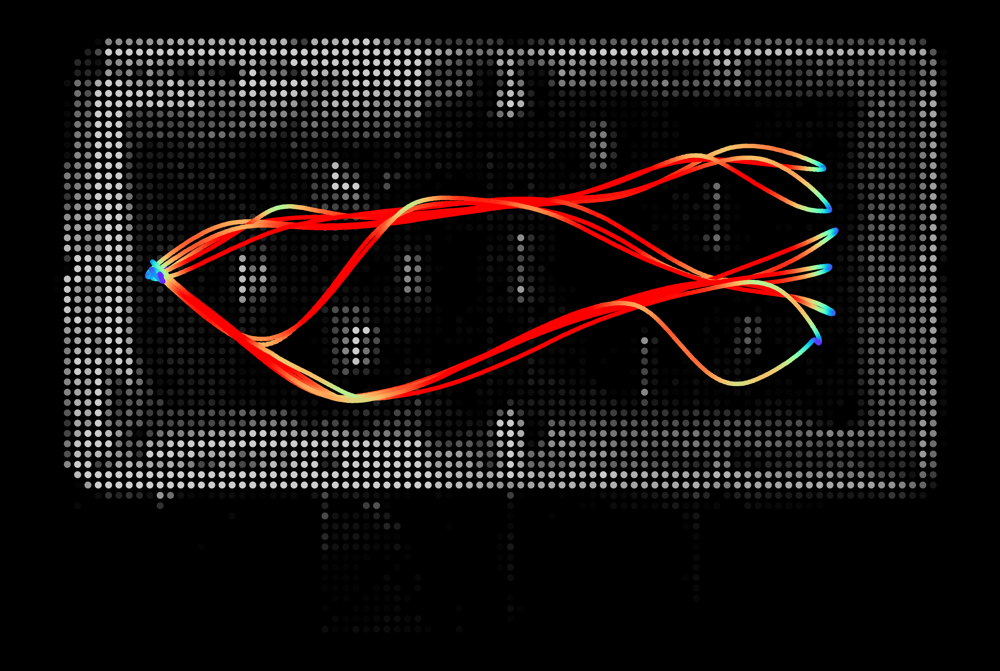

In [420]:
# plot the point cloud data
# topic = "/PX03/mid360_PointCloud2"
topic = "/PX03/static_grid_topic"
test_num = 5

bag_path = f"/media/kkondo/T7/MIGHTY/test{test_num}/rosbag2_2025_10_10-14_09_22"
pc, pcd, pd, marker_data = get_pc(bag_path, topic, child_frame="/PX03/base_link")

paper_path = "/home/kkondo/paper_writing/mighty_paper/mighty_paper/figures/hw/"
pc, marker_xyz, marker_colors = plot_pc(pc, pcd, pd, marker_data, paper_path, f"/test{test_num}/hw_test{test_num}_overhead_pc.png", max_vel = 3.0, use_uniform_times=True)
# plot_with_angle(pc, marker_xyz, marker_colors, paper_path, f"/hw_test{test_num}_side_view_pc.png")

pc_frame: map


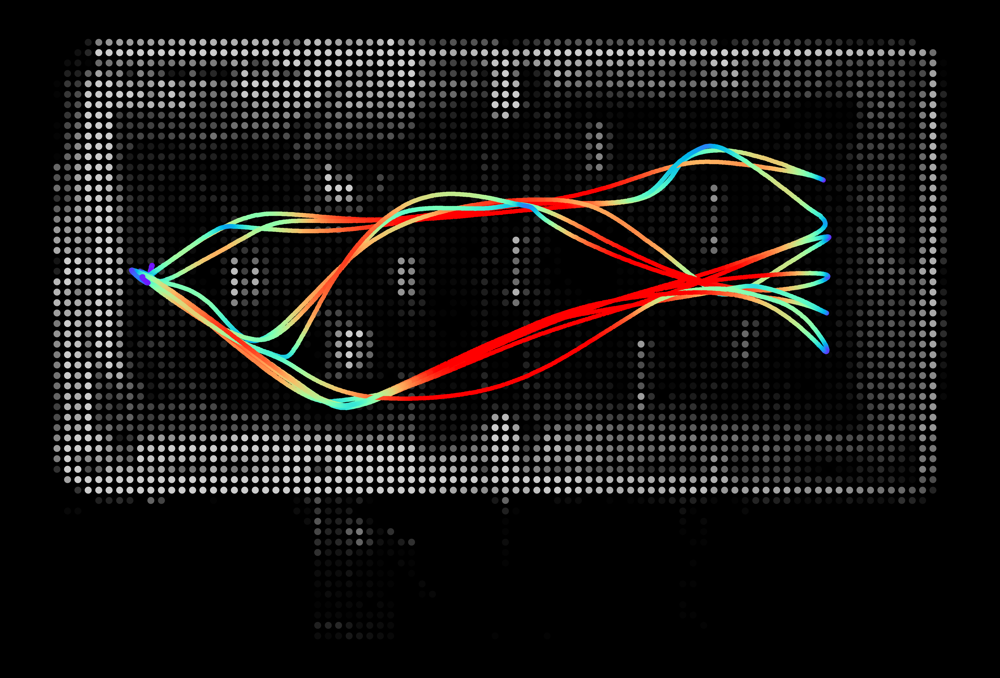

In [ ]:
# plot the point cloud data
# topic = "/PX03/mid360_PointCloud2"
topic = "/PX03/static_grid_topic"
test_num = 6

bag_path = f"/media/kkondo/T7/MIGHTY/test{test_num}/rosbag2_2025_10_10-15_02_51"
pc, pcd, pd, marker_data = get_pc(bag_path, topic, child_frame="/PX03/base_link")

paper_path = "/home/kkondo/paper_writing/mighty_paper/mighty_paper/figures/hw/"
pc, marker_xyz, marker_colors = plot_pc(pc, pcd, pd, marker_data, paper_path, f"/test{test_num}/hw_test{test_num}_overhead_pc.png", max_vel = 4.0, use_uniform_times=True)
# plot_with_angle(pc, marker_xyz, marker_colors, paper_path, f"/hw_test{test_num}_side_view_pc.png")

pc_frame: map
size of marker_data before skip: 6206
[Info] Generating 30 point clouds between t=1760131156.0965252 and t=1760131218.1528625


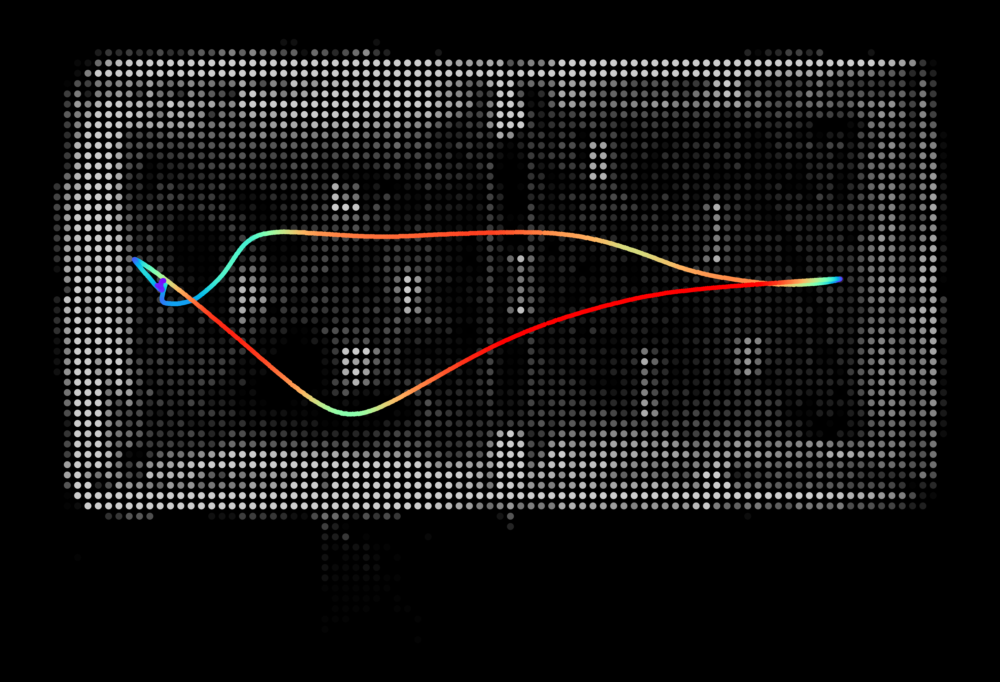

In [421]:
# plot the point cloud data
# topic = "/PX03/mid360_PointCloud2"
topic = "/PX03/static_grid_topic"
test_num = 9

bag_path = f"/media/kkondo/T7/MIGHTY/test{test_num}/rosbag2_2025_10_10-17_19_15"
pc, pcd, pd, marker_data = get_pc(bag_path, topic, child_frame="/PX03/base_link")

skip_idx = 3600
print("size of marker_data before skip:", len(marker_data._data))
marker_data._data = marker_data._data[skip_idx:]
marker_data.times = marker_data.times[skip_idx:]
paper_path = "/home/kkondo/paper_writing/mighty_paper/mighty_paper/figures/hw/"
pc, marker_xyz, marker_colors = plot_pc(pc, pcd, pd, marker_data, paper_path, f"/test{test_num}/hw_test{test_num}_overhead_pc.png", max_vel = 5.0, peak_time=44.0)
# plot_with_angle(pc, marker_xyz, marker_colors, paper_path, f"/hw_test{test_num}_side_view_pc.png")

pc_frame: map
size of marker_data before skip: 19983
[Info] Generating 30 point clouds between t=1760133041.2523024 and t=1760133240.972371


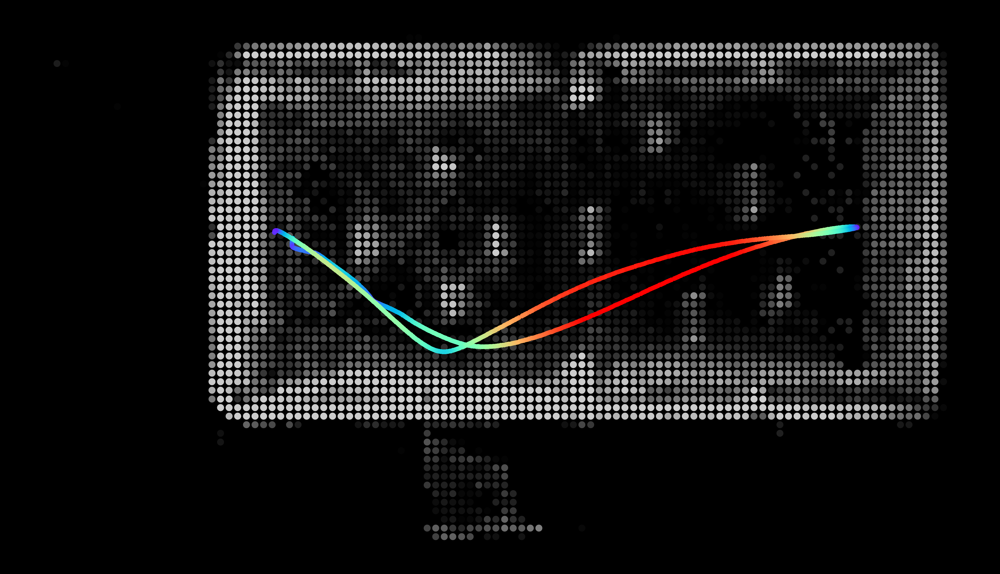

In [422]:
# plot the point cloud data
# topic = "/PX03/mid360_PointCloud2"
topic = "/PX03/static_grid_topic"
test_num = 10

bag_path = f"/media/kkondo/T7/MIGHTY/test{test_num}/rosbag2_2025_10_10-17_50_41"
pc, pcd, pd, marker_data = get_pc(bag_path, topic, child_frame="/PX03/base_link")

skip_idx = 15550
cutoff_idx = 17200
print("size of marker_data before skip:", len(marker_data._data))
marker_data._data = marker_data._data[skip_idx:cutoff_idx]
marker_data.times = marker_data.times[skip_idx:cutoff_idx]
paper_path = "/home/kkondo/paper_writing/mighty_paper/mighty_paper/figures/hw/"
pc, marker_xyz, marker_colors = plot_pc(pc, pcd, pd, marker_data, paper_path, f"/test{test_num}/hw_test{test_num}_overhead_pc.png", max_vel = 6.0, peak_time=163.8)
# plot_with_angle(pc, marker_xyz, marker_colors, paper_path, f"/hw_test{test_num}_side_view_pc.png")

pc_frame: map
size of marker_data before skip: 8431
[Info] Generating 30 point clouds between t=1760133420.1150756 and t=1760133504.40032


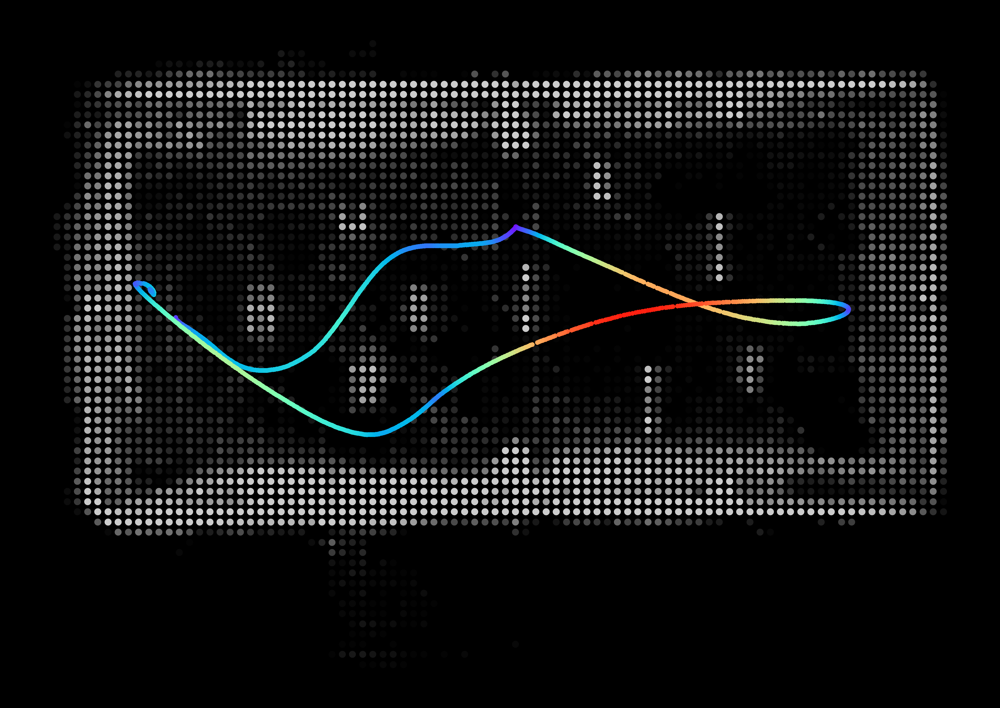

In [423]:
# plot the point cloud data
# topic = "/PX03/mid360_PointCloud2"
topic = "/PX03/static_grid_topic"
test_num = 11

bag_path = f"/media/kkondo/T7/MIGHTY/test{test_num}/rosbag2_2025_10_10-17_56_59"
pc, pcd, pd, marker_data = get_pc(bag_path, topic, child_frame="/PX03/base_link")

skip_idx = 5050
cutoff_idx = 7300
print("size of marker_data before skip:", len(marker_data._data))
marker_data._data = marker_data._data[skip_idx:cutoff_idx]
marker_data.times = marker_data.times[skip_idx:cutoff_idx]
paper_path = "/home/kkondo/paper_writing/mighty_paper/mighty_paper/figures/hw/"
pc, marker_xyz, marker_colors = plot_pc(pc, pcd, pd, marker_data, paper_path, f"/test{test_num}/hw_test{test_num}_overhead_pc.png", max_vel = 7.0, peak_time=62.5)
# plot_with_angle(pc, marker_xyz, marker_colors, paper_path, f"/hw_test{test_num}_side_view_pc.png")

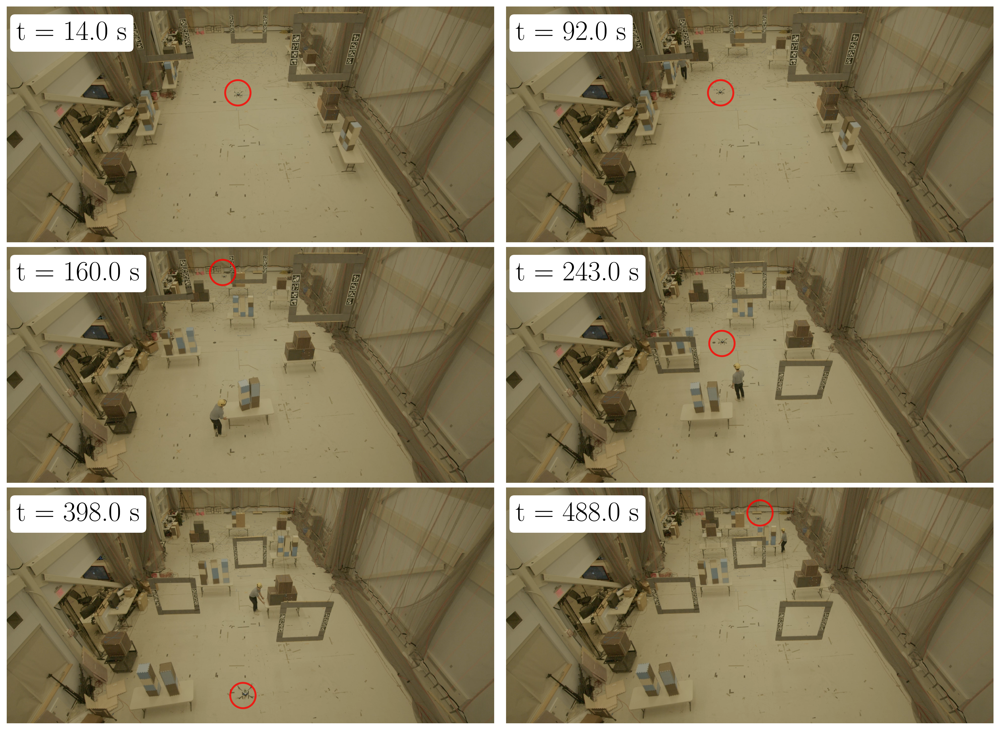

[OK] Saved: /home/kkondo/paper_writing/mighty_paper/mighty_paper/figures/hw/test13/combined_hw_dynamic.png


In [528]:
import os
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import gridspec, font_manager
from matplotlib.patches import Circle

# ================== User parameters ==================
output_folder = "/home/kkondo/paper_writing/mighty_paper/mighty_paper/figures/hw/test13"
filenames = [f"test13_frame{i}.png" for i in range(1, 7)]  # test13_frame_1.png ... _6.png

# Crop (pixels from top and bottom before plotting)
CROP_TOP = 50
CROP_BOTTOM = 100

# Grid
ROWS, COLS = 3, 2
FIG_DPI = 300
FIG_W = 15    # inches
FIG_H = 11    # inches

# Labels and title
LABELS = ["1", "2", "3", "4", "5", "6"]
LABEL_SIZE = 30         # Matplotlib points
TITLE_TEXT = ""  # "" to skip title
TITLE_SIZE = 40
BADGE_PAD = 0.2        # bbox pad (in "boxstyle" units)
BADGE_EDGE = 1.5
BADGE_ROUND = 0.15      # rounding parameter for 'round' style
LABEL_OFFSET = (0.02, 0.06)  # (x,y) in Axes fraction from top-left

# Fonts
USE_TEX = False  # set True if you have LaTeX installed and want TeX rendering
TNR_PATH = None  # if you want to be explicit: e.g., "/System/Library/Fonts/Supplemental/Times New Roman.ttf"

# Time
time_start = 72
time_frame1 = 86
time_frame2 = 164
time_frame3 = 232
time_frame4 = 315
time_frame5 = 470
time_frame6 = 560

TIME_STAMPS = [time_frame1, time_frame2, time_frame3, time_frame4, time_frame5, time_frame6]
TIME_MODE = "relative"   # "relative" (t - time_start) or "absolute"
TIME_DECIMALS = 1        # number of decimals to show
TIME_UNIT = "s"          # label unit

def _format_time_label(t):
    if TIME_MODE == "relative":
        val = float(t) - float(time_start)
    else:
        val = float(t)
    return f"t = {val:.{TIME_DECIMALS}f} {TIME_UNIT}"

# ================== Setup fonts ==================
plt.rcParams.update({"text.usetex": USE_TEX})
if TNR_PATH is not None and os.path.exists(TNR_PATH):
    font_manager.fontManager.addfont(TNR_PATH)
font = font_manager.FontProperties()
font.set_family('serif')
font.set_size(30)
plt.rcParams.update({"text.usetex": True})
plt.rcParams["font.family"] = "Times New Roman"

# ================== Load and crop images ==================
def load_and_crop(path, crop_top, crop_bottom):
    img = plt.imread(path)  # returns RGB (or RGBA)
    if img is None:
        raise FileNotFoundError(f"Could not read {path}")
    if img.ndim == 2:
        img = np.stack([img]*3, axis=-1)  # grayscale -> RGB
    h = img.shape[0]
    top = max(0, min(crop_top, h-1))
    bottom = max(0, min(crop_bottom, h-1))
    if top + bottom >= h:
        top = h//4
        bottom = h//4
    return img[top:h-bottom, :, :]

images = []
for i, name in enumerate(filenames):
    path = os.path.join(output_folder, name)
    if not os.path.exists(path):
        # lightweight placeholder so the grid still renders
        ph = np.full((540, 960, 3), 0.9, dtype=float)
        images.append(ph)
        print(f"[WARN] Missing file, using placeholder: {path}")
        continue
    images.append(load_and_crop(path, CROP_TOP, CROP_BOTTOM))

# Make sure we have exactly ROWS*COLS images
total_tiles = ROWS * COLS
if len(images) < total_tiles:
    images += [np.full((540, 960, 3), 0.9, dtype=float)] * (total_tiles - len(images))
elif len(images) > total_tiles:
    images = images[:total_tiles]

# Also make sure TIME_STAMPS aligns with images
if len(TIME_STAMPS) < total_tiles:
    TIME_STAMPS += [TIME_STAMPS[-1]] * (total_tiles - len(TIME_STAMPS))
elif len(TIME_STAMPS) > total_tiles:
    TIME_STAMPS = TIME_STAMPS[:total_tiles]

# ================== Circle settings (optional) ==================
# Provide per-tile centers in CROPPED-IMAGE PIXELS (x,y), origin = top-left after cropping
circle_centers_px = [
    (910, 340),  # tile 1
    (845, 340),  # tile 2
    (850, 100),  # tile 3
    (850, 380), # tile 4
    (930, 820),  # tile 5
    (1000, 100),  # tile 6
]
# Or use axes fractions instead by setting circle_centers_frac and circle_centers_px=None
circle_centers_frac = None

circle_radius_px = 50
circle_radius_frac = 0.01
circle_edge_width = 2.0
circle_edge_color = 'red'
circle_face_color = 'none'
circle_alpha = 0.8

# ================== Figure and axes ==================
fig = plt.figure(figsize=(FIG_W, FIG_H), dpi=FIG_DPI, facecolor="white")
gs = gridspec.GridSpec(ROWS, COLS, figure=fig, wspace=0.02, hspace=0.02)

# Optional title
if TITLE_TEXT:
    fig.suptitle(TITLE_TEXT, fontsize=TITLE_SIZE, y=0.98, va='top')

# ================== Plot tiles (single clean loop) ==================
for idx, img in enumerate(images):
    r, c = divmod(idx, COLS)
    ax = fig.add_subplot(gs[r, c])
    ax.imshow(img)
    ax.axis("off")

    # ----- Time badge (replaces numeric labels) -----
    x_frac = LABEL_OFFSET[0]
    y_frac = 1.0 - LABEL_OFFSET[1]
    ax.text(
        x_frac, y_frac, _format_time_label(TIME_STAMPS[idx]),
        transform=ax.transAxes, ha='left', va='top',
        fontsize=LABEL_SIZE, color='black', family='Times New Roman',
        bbox=dict(
            boxstyle=f"round,pad={BADGE_PAD},rounding_size={BADGE_ROUND}",
            facecolor='white', edgecolor='white', linewidth=BADGE_EDGE
        ),
        zorder=5,
    )

    # ----- Optional red circle -----
    h, w = img.shape[0], img.shape[1]

    if circle_centers_px is not None:
        cx, cy = circle_centers_px[idx]
        cx = min(max(0, cx), w-1)
        cy = min(max(0, cy), h-1)
        rad = circle_radius_px
        circ = Circle(
            (cx, cy), radius=rad,
            edgecolor=circle_edge_color, facecolor=circle_face_color,
            linewidth=circle_edge_width, alpha=circle_alpha,
            transform=ax.transData, zorder=6
        )
        ax.add_patch(circ)

    elif circle_centers_frac is not None:
        fx, fy = circle_centers_frac[idx]
        cx = fx * (w - 1)
        cy = fy * (h - 1)
        rad = circle_radius_frac * min(w, h)
        circ = Circle(
            (cx, cy), radius=rad,
            edgecolor=circle_edge_color, facecolor=circle_face_color,
            linewidth=circle_edge_width, alpha=circle_alpha,
            transform=ax.transData, zorder=6
        )
        ax.add_patch(circ)

# Tight layout without squeezing suptitle
plt.subplots_adjust(top=0.99, left=0.01, right=0.99, bottom=0.02)

# ================== Show and Save ==================
plt.show()

save_path = os.path.join(output_folder, "combined_hw_dynamic.png")
os.makedirs(output_folder, exist_ok=True)
fig.savefig(save_path, bbox_inches="tight", facecolor="white")
print(f"[OK] Saved: {save_path}")


In [281]:
import os
import numpy as np
import matplotlib.pyplot as plt

def compose_inset_image(
    base_image_path,
    inset_image_path,
    save_path,
    *,
    # Cropping (top, right, bottom, left) in pixels
    trim_base=(0, 0, 0, 0),
    trim_inset=(0, 0, 0, 0),

    # Rotate inset by multiples of 90 degrees (…,-180,-90,0,90,180,270,…)
    rotate_inset_deg=0,

    # Placement mode: "pixel" (absolute px in base-image coords) or "fraction"
    placement="pixel",

    # Pixel mode (in base-image px AFTER cropping)
    inset_width_px=400,
    inset_left_px=40,
    inset_vcenter_px=None,  # None => auto center vertically

    # Fraction mode (relative to base axes 0..1)
    inset_width_frac=0.3,
    inset_left_frac=0.05,
    inset_vcenter_frac=0.5,

    # Border around inset
    draw_border=True,
    border_color="black",
    border_lw=1.5,

    # Figure/Export
    dpi=300,
    margin_px=10,
    bg_color="white",
    show=False,            # True => plt.show()
):
    """
    Create a composite image with an inset over a base image.

    Parameters
    ----------
    base_image_path : str
        Path to the base (background) image.
    inset_image_path : str
        Path to the inset (foreground) image.
    save_path : str
        Where to save the composite PNG (directory auto-created).
    trim_base, trim_inset : (top, right, bottom, left)
        Pixel trims applied before placement.
    rotate_inset_deg : int
        Multiple of 90 degrees. Positive = CCW, negative = CW.
    placement : {"pixel", "fraction"}
        - "pixel": place inset in base-image pixel coordinates.
        - "fraction": place inset using axis fractions (0..1).
    inset_width_px / inset_left_px / inset_vcenter_px :
        Used only when placement="pixel".
    inset_width_frac / inset_left_frac / inset_vcenter_frac :
        Used only when placement="fraction".
    draw_border : bool
        Draw a border around the inset.
    border_color : str
    border_lw : float
    dpi : int
    margin_px : int
    bg_color : str
    show : bool
        If True, calls plt.show().

    Returns
    -------
    save_path : str
        The path of the saved figure.
    fig, (ax_base, ax_inset)
        Matplotlib figure and axes.
    """

    # ----------------- helpers -----------------
    def _load_as_uint8(path):
        if not os.path.exists(path):
            raise FileNotFoundError(path)
        img = plt.imread(path)
        if img.dtype != np.uint8:
            img = (np.clip(img, 0, 1) * 255).astype(np.uint8)
        if img.ndim == 2:
            img = np.stack([img]*3, axis=-1)
        if img.shape[2] == 4:
            img = img[:, :, :3]
        return img

    def _apply_trim(img, trim):
        t, r, b, l = trim
        h, w = img.shape[:2]
        t = max(0, min(t, h-1)); b = max(0, min(b, h-1))
        l = max(0, min(l, w-1)); r = max(0, min(r, w-1))
        # guard against over-trim
        if t + b >= h:
            t = h // 4; b = h // 4
        if l + r >= w:
            l = w // 4; r = w // 4
        return img[t:h-b, l:w-r]

    def _rotate_90s(img, deg):
        d = ((deg % 360) + 360) % 360
        if d == 0:   return img
        if d == 90:  return np.rot90(img, k=1)
        if d == 180: return np.rot90(img, k=2)
        if d == 270: return np.rot90(img, k=3)
        raise ValueError("rotate_inset_deg must be a multiple of 90")

    # ----------------- load/prepare images -----------------
    img_base  = _apply_trim(_load_as_uint8(base_image_path),  trim_base)
    img_inset = _apply_trim(_load_as_uint8(inset_image_path), trim_inset)
    img_inset = _rotate_90s(img_inset, rotate_inset_deg)

    h1, w1 = img_base.shape[:2]
    h2, w2 = img_inset.shape[:2]

    # ----------------- figure sized to base image -----------------
    fig_w_in = (w1 + 2*margin_px) / dpi
    fig_h_in = (h1 + 2*margin_px) / dpi

    fig = plt.figure(figsize=(fig_w_in, fig_h_in), dpi=dpi, facecolor=bg_color)
    ax = fig.add_axes([
        margin_px / (w1 + 2*margin_px),
        margin_px / (h1 + 2*margin_px),
        w1 / (w1 + 2*margin_px),
        h1 / (h1 + 2*margin_px),
    ])
    ax.imshow(img_base, origin="upper", interpolation="none")
    ax.set_xlim(0, w1); ax.set_ylim(h1, 0)
    ax.axis("off")

    # ----------------- place inset -----------------
    if placement == "pixel":
        inset_w = float(inset_width_px)
        inset_h = inset_w * (h2 / float(w2))

        x_left = float(inset_left_px)
        if inset_vcenter_px is None:
            y_center = h1 / 2.0
        else:
            y_center = float(inset_vcenter_px)
        y_top = y_center - inset_h / 2.0

        # clamp to base
        x_left = max(0.0, min(x_left, max(0.0, w1 - inset_w)))
        y_top  = max(0.0, min(y_top,  max(0.0, h1 - inset_h)))

        ax_in = ax.inset_axes([x_left, y_top, inset_w, inset_h], transform=ax.transData)
    elif placement == "fraction":
        width_frac = float(inset_width_frac)
        # maintain aspect on axes: compute required height fraction
        axpos = ax.get_position()
        fig_w, fig_h = fig.get_size_inches()
        axes_aspect_box = (axpos.height * fig_h) / (axpos.width * fig_w)
        height_frac = width_frac * axes_aspect_box * (h2 / float(w2))

        left_frac   = float(inset_left_frac)
        bottom_frac = float(inset_vcenter_frac) - height_frac / 2.0

        bottom_frac = max(0.0, min(1.0 - height_frac, bottom_frac))
        left_frac   = max(0.0, min(1.0 - width_frac,  left_frac))

        ax_in = ax.inset_axes([left_frac, bottom_frac, width_frac, height_frac], transform=ax.transAxes)
    else:
        raise ValueError('placement must be "pixel" or "fraction"')

    ax_in.imshow(img_inset, origin="upper", interpolation="none")
    ax_in.set_xlim(0, w2); ax_in.set_ylim(h2, 0)
    ax_in.axis("off")

    if draw_border:
        for s in ax_in.spines.values():
            s.set_edgecolor(border_color)
            s.set_linewidth(border_lw)
            s.set_visible(True)

    # ----------------- save/show -----------------
    os.makedirs(os.path.dirname(save_path), exist_ok=True)
    fig.savefig(save_path, bbox_inches="tight", facecolor=bg_color)
    if show:
        plt.show()
    else:
        plt.close(fig)
    return save_path, (fig, (ax, ax_in))


In [510]:
# Test 6
output_folder = "/home/kkondo/paper_writing/mighty_paper/mighty_paper/figures/hw/test6"
top_image_path    = os.path.join(output_folder, "atam_action_seq.png")
bottom_image_path = os.path.join(output_folder, "hw_test6_overhead_pc.png")
save_name = "combined_test6.png"
save_path = os.path.join(output_folder, save_name)

_ = compose_inset_image(
    base_image_path=top_image_path,
    inset_image_path=bottom_image_path,
    save_path=save_path,
    trim_base=(33, 400, 35, 300),          # TRIM_TOP
    trim_inset=(80, 100, 660, 100),    # TRIM_INSET
    rotate_inset_deg=-90,
    placement="pixel",                 # choose "pixel" or "fraction"
    # Pixel mode params:
    inset_width_px=350,
    inset_left_px=7,
    inset_vcenter_px=530,             # None => auto center vertically
    # Fraction mode params (ignored in pixel mode):
    inset_width_frac=0.5,
    inset_left_frac=0.02,
    inset_vcenter_frac=0.40,
    # Border
    draw_border=True,
    border_color="black",
    border_lw=1.5,
    # Figure/export
    dpi=300,
    margin_px=10,
    bg_color="white",
    show=False,
)

print("[OK] Saved to:", save_path)


[OK] Saved to: /home/kkondo/paper_writing/mighty_paper/mighty_paper/figures/hw/test6/combined_test6.png


In [ ]:
# Test 9
output_folder = "/home/kkondo/paper_writing/mighty_paper/mighty_paper/figures/hw/test9"
top_image_path    = os.path.join(output_folder, "gopro_west.png")
bottom_image_path = os.path.join(output_folder, "hw_test9_overhead_pc.png")
save_name = "combined_test9.png"
save_path = os.path.join(output_folder, save_name)

_ = compose_inset_image(
    base_image_path=top_image_path,
    inset_image_path=bottom_image_path,
    save_path=save_path,
    trim_base=(340, 300, 200, 400),          # TRIM_TOP
    trim_inset=(100, 100, 600, 100),    # TRIM_INSET
    rotate_inset_deg=0,
    placement="pixel",                 # choose "pixel" or "fraction"
    # Pixel mode params:
    inset_width_px=800,
    inset_left_px=40,
    inset_vcenter_px=250,
    # Fraction mode params (ignored in pixel mode):
    inset_width_frac=0.5,
    inset_left_frac=0.02,
    inset_vcenter_frac=0.40,
    # Border
    draw_border=True,
    border_color="black",
    border_lw=1.5,
    # Figure/export
    dpi=300,
    margin_px=10,
    bg_color="white",
    show=False,
)

print("[OK] Saved to:", save_path)


[OK] Saved to: /home/kkondo/paper_writing/mighty_paper/mighty_paper/figures/hw/test9/combined_test9.png


In [532]:
# Test 10
output_folder = "/home/kkondo/paper_writing/mighty_paper/mighty_paper/figures/hw/test10"
top_image_path    = os.path.join(output_folder, "atam_action_sequence.png")
bottom_image_path = os.path.join(output_folder, "hw_test10_overhead_pc.png")
save_name = "combined_test10.png"
save_path = os.path.join(output_folder, save_name)

_ = compose_inset_image(
    base_image_path=top_image_path,
    inset_image_path=bottom_image_path,
    save_path=save_path,
    trim_base=(50, 500, 50, 0),          # TRIM_TOP
    trim_inset=(110, 200, 570, 800),    # TRIM_INSET
    rotate_inset_deg=-90,
    placement="pixel",                 # choose "pixel" or "fraction"
    # Pixel mode params:
    inset_width_px=400,
    inset_left_px=40,
    inset_vcenter_px=570,
    # Fraction mode params (ignored in pixel mode):
    inset_width_frac=0.5,
    inset_left_frac=0.02,
    inset_vcenter_frac=0.40,
    # Border
    draw_border=True,
    border_color="black",
    border_lw=1.5,
    # Figure/export
    dpi=300,
    margin_px=10,
    bg_color="white",
    show=False,
)

print("[OK] Saved to:", save_path)


[OK] Saved to: /home/kkondo/paper_writing/mighty_paper/mighty_paper/figures/hw/test10/combined_test10.png


In [428]:
# Test 11
output_folder = "/home/kkondo/paper_writing/mighty_paper/mighty_paper/figures/hw/test11"
top_image_path    = os.path.join(output_folder, "atam_action_sequence.png")
bottom_image_path = os.path.join(output_folder, "hw_test11_overhead_pc.png")
save_name = "combined_test11.png"
save_path = os.path.join(output_folder, save_name)

_ = compose_inset_image(
    base_image_path=top_image_path,
    inset_image_path=bottom_image_path,
    save_path=save_path,
    trim_base=(50, 400, 50, 0),          # TRIM_TOP
    trim_inset=(220, 200, 610, 200),    # TRIM_INSET
    rotate_inset_deg=0,
    placement="pixel",                 # choose "pixel" or "fraction"
    # Pixel mode params:
    inset_width_px=800,
    inset_left_px=40,
    inset_vcenter_px=700,
    # Fraction mode params (ignored in pixel mode):
    inset_width_frac=0.5,
    inset_left_frac=0.02,
    inset_vcenter_frac=0.40,
    # Border
    draw_border=True,
    border_color="black",
    border_lw=1.5,
    # Figure/export
    dpi=300,
    margin_px=10,
    bg_color="white",
    show=False,
)

print("[OK] Saved to:", save_path)


[OK] Saved to: /home/kkondo/paper_writing/mighty_paper/mighty_paper/figures/hw/test11/combined_test11.png


[OK] Saved: /home/kkondo/paper_writing/mighty_paper/mighty_paper/figures/hw/three_panel_top_1_bottom_2.png


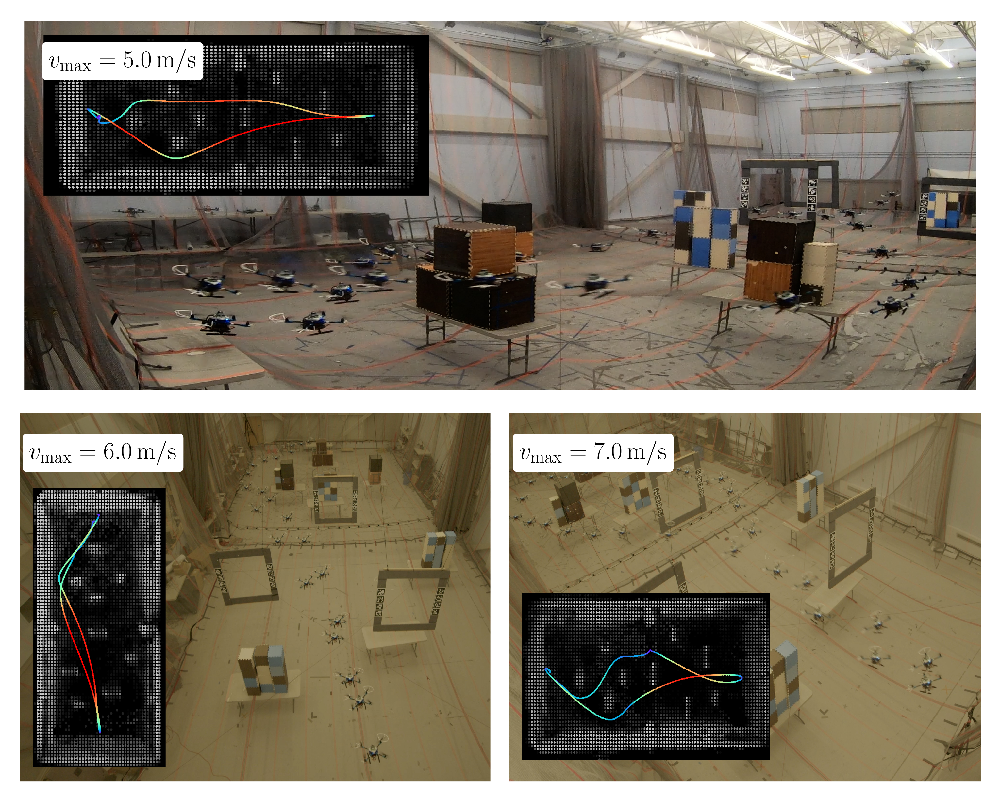

In [ ]:
import os
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import gridspec, font_manager

# ================== User parameters ==================
output_folder = "/home/kkondo/paper_writing/mighty_paper/mighty_paper/figures/hw/"

# Use the first three images for the new layout:
filenames = [
    "test9/combined_test9.png",  # image 1 (TOP)
    "test10/combined_test10.png",  # image 2 (BOTTOM-LEFT)
    "test11/combined_test11.png",  # image 3 (BOTTOM-RIGHT)
]

# -------- Cropping ----------
CROP_UNITS = "px"   # "px" or "frac"
GLOBAL_CROP = dict(top=0, bottom=0, left=0, right=0)

PER_IMAGE_CROP = [
    dict(top=0, bottom=0, left=0, right=0),  # image 1
    dict(top=0, bottom=0, left=0, right=0),  # image 2
    dict(top=0, bottom=0, left=0, right=0),  # image 3
]

# -------- Figure/Layout ----------
FIG_DPI = 300
FIG_W = 10
FIG_H = 8

# Small per-image title badge (LaTeX/mathtext)
USE_TEX = False
LABEL_SIZE = 18
BADGE_PAD = 0.25
BADGE_EDGE = 1.0
BADGE_ROUND = 0.15
LABEL_OFFSET = (0.04, 0.1)  # (x,y) from top-left in Axes fraction

# Fonts (unchanged)
TNR_PATH = None

# v_max labels for images 1..3
vmax_values = [5.0, 6.0, 7.0]  # m/s

# Save
save_name = "three_panel_top_1_bottom_2.png"

# ================== Setup fonts and TeX (unchanged) ==================
plt.rcParams.update({"text.usetex": USE_TEX})
if TNR_PATH is not None and os.path.exists(TNR_PATH):
    font_manager.fontManager.addfont(TNR_PATH)
font = font_manager.FontProperties()
font.set_family('serif')
font.set_size(30)
plt.rcParams.update({"text.usetex": True})
plt.rcParams["font.family"] = "Times New Roman"

# ================== Helpers (same as before) ==================
def _normalize_crop(crop, shape, units):
    h, w = shape[0], shape[1]
    c = {"top": 0, "bottom": 0, "left": 0, "right": 0}
    if crop:
        c.update({k: crop[k] for k in ("top", "bottom", "left", "right") if k in crop})
    if units == "px":
        top = int(np.clip(c["top"], 0, h - 1))
        bottom = int(np.clip(c["bottom"], 0, h - 1))
        left = int(np.clip(c["left"], 0, w - 1))
        right = int(np.clip(c["right"], 0, w - 1))
    elif units == "frac":
        top = int(np.clip(float(c["top"]), 0.0, 1.0) * h)
        bottom = int(np.clip(float(c["bottom"]), 0.0, 1.0) * h)
        left = int(np.clip(float(c["left"]), 0.0, 1.0) * w)
        right = int(np.clip(float(c["right"]), 0.0, 1.0) * w)
    else:
        raise ValueError("CROP_UNITS must be 'px' or 'frac'")
    if top + bottom >= h:
        top = h // 4
        bottom = h // 4
    if left + right >= w:
        left = w // 4
        right = w // 4
    return top, bottom, left, right

def load_and_crop(path, global_crop, per_image_crop, units):
    img = plt.imread(path)
    if img.ndim == 2:
        img = np.stack([img]*3, axis=-1)
    if img.shape[-1] == 4:
        img = img[..., :3]
    crop = per_image_crop if per_image_crop is not None else global_crop
    top, bottom, left, right = _normalize_crop(crop, img.shape, units)
    return img[top:img.shape[0]-bottom, left:img.shape[1]-right, :]

def small_badge(ax, text):
    x_frac = LABEL_OFFSET[0]
    y_frac = 1.0 - LABEL_OFFSET[1]
    ax.text(
        x_frac, y_frac, text,
        transform=ax.transAxes, ha='right', va='top',
        fontsize=LABEL_SIZE, color='black', family='Times New Roman',
        bbox=dict(
            boxstyle=f"round,pad={BADGE_PAD},rounding_size={BADGE_ROUND}",
            facecolor='white', edgecolor='white', linewidth=BADGE_EDGE
        ),
        zorder=5,
    )

def latex_vmax(v):
    return rf"$v_{{\max}}={v:.1f}\,\mathrm{{m/s}}$"

# ================== Load images (with crop) ==================
images = []
for i, name in enumerate(filenames[:3]):
    path = name if os.path.isabs(name) else os.path.join(output_folder, name)
    if not os.path.exists(path):
        print(f"[WARN] Missing file, using placeholder: {path}")
        images.append(np.full((540, 960, 3), 0.9, dtype=float))
        continue
    img = load_and_crop(
        path,
        GLOBAL_CROP,
        PER_IMAGE_CROP[i] if i < len(PER_IMAGE_CROP) else None,
        CROP_UNITS,
    )
    images.append(img)

# Ensure exactly 3
if len(images) < 3:
    images += [np.full((540, 960, 3), 0.9, dtype=float)] * (3 - len(images))
elif len(images) > 3:
    images = images[:3]

# ================== Figure and GridSpec (top 1, bottom 2) ==================
# ================== Figure and GridSpec (top 1, bottom 2) ==================
fig = plt.figure(figsize=(FIG_W, FIG_H), dpi=FIG_DPI, facecolor="white")

# --- Control the top:bottom height split here ---
TOP_HEIGHT   = 1.2   # increase to make the top row taller
BOTTOM_HEIGHT = 1.0  # relative weight for the bottom row
# -------------------------------------------------

gs = gridspec.GridSpec(
    nrows=2, ncols=2, figure=fig,
    width_ratios=[1, 1],                      # bottom panels same width
    height_ratios=[TOP_HEIGHT, BOTTOM_HEIGHT],# top:bottom ratio
    wspace=0.0, hspace=0.0                    # no gutters
)

ax_top = fig.add_subplot(gs[0, :])  # row 0 spans both columns
ax_bl  = fig.add_subplot(gs[1, 0])  # bottom-left
ax_br  = fig.add_subplot(gs[1, 1])  # bottom-right

axes = [ax_top, ax_bl, ax_br]

# ================== Plotting ==================
for ax, img, v in zip(axes, images, vmax_values):
    # Fill the axes without cropping; keep pixel aspect consistent within the axes
    ax.imshow(img)
    ax.set_aspect('auto')           # let image scale to fill the axes (no cropping)
    ax.set_anchor('C')              # center the image within its axes if aspect differs
    ax.set_xticks([]); ax.set_yticks([])
    for s in ax.spines.values():
        s.set_visible(False)
    small_badge(ax, latex_vmax(v))

# Make the top axis exactly the combined width of bottom axes (already true since it spans both columns)
# Remove outer margins to avoid any hairline gaps
fig.subplots_adjust(left=0, right=1, top=1, bottom=0)

# ================== Save / Show ==================
os.makedirs(output_folder, exist_ok=True)
save_path = os.path.join(output_folder, save_name)
fig.savefig(save_path, facecolor="white", bbox_inches='tight', pad_inches=0)
print(f"[OK] Saved: {save_path}")

plt.show()


[OK] Saved: /home/kkondo/paper_writing/mighty_paper/mighty_paper/figures/hw/four_panel_layout.png


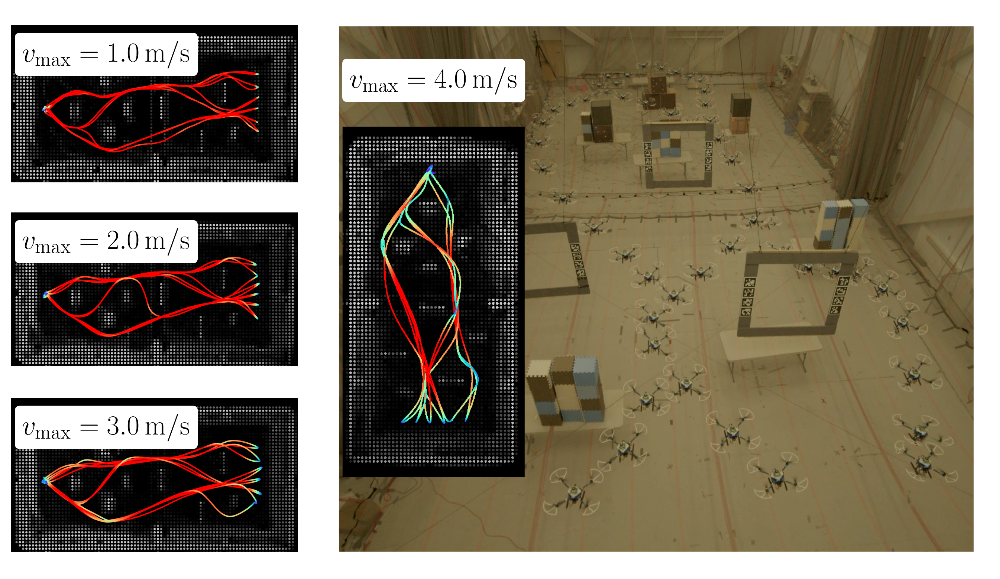

In [524]:
import os
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import gridspec, font_manager

# ================== User parameters ==================
output_folder = "/home/kkondo/paper_writing/mighty_paper/mighty_paper/figures/hw/"

# Four images: 1–3 stacked left, 4 fills right
filenames = [
    "test2/hw_test2_overhead_pc.png",  # top-left
    "test3/hw_test3_overhead_pc.png",  # middle-left
    "test5/hw_test5_overhead_pc.png",  # bottom-left
    "test6/combined_test6.png",        # right full height
]

# -------- Cropping ----------
# Global crop to apply to all images by default.
# Units can be "px" (pixels) or "frac" (fractions of width/height in [0,1]).
CROP_UNITS = "px"   # "px" or "frac"
GLOBAL_CROP = dict(top=0, bottom=0, left=0, right=0)

# Per-image crop overrides (same keys). Use None to inherit GLOBAL_CROP.
PER_IMAGE_CROP = [
    dict(top=50, bottom=700, left=190, right=190),  # image 1
    dict(top=50, bottom=700, left=200, right=200),  # image 2
    dict(top=50, bottom=700, left=200, right=200),  # image 3
    None,  # image 4
]

# -------- Figure/Layout ----------
FIG_DPI = 300
FIG_W = 9    # inches
FIG_H = 5     # inches

# 1:3 width ratio (left column : right column)
WIDTH_RATIO_LEFT = 1.2
WIDTH_RATIO_RIGHT = 3

# Small per-image title badge (LaTeX/mathtext)
USE_TEX = False     # set True if you have a TeX install; otherwise mathtext handles v_max fine
LABEL_SIZE = 18
BADGE_PAD = 0.25    # bbox "pad" for 'round' style
BADGE_EDGE = 1.0
BADGE_ROUND = 0.15
LABEL_OFFSET = (0.04, 0.1)  # (x,y) from top-left in Axes fraction

# Fonts (optional)
TNR_PATH = None  # e.g., "/System/Library/Fonts/Supplemental/Times New Roman.ttf"

# v_max labels for images 1..4
vmax_values = [1.0, 2.0, 3.0, 4.0]  # m/s

# Save
save_name = "four_panel_layout.png"

# ================== Setup fonts and TeX ==================
plt.rcParams.update({"text.usetex": USE_TEX})
if TNR_PATH is not None and os.path.exists(TNR_PATH):
    font_manager.fontManager.addfont(TNR_PATH)
font = font_manager.FontProperties()
font.set_family('serif')
font.set_size(30)
plt.rcParams.update({"text.usetex": True})
plt.rcParams["font.family"] = "Times New Roman"

# ================== Helpers ==================
def _normalize_crop(crop, shape, units):
    """Convert crop dict into pixel counts (top, bottom, left, right)."""
    h, w = shape[0], shape[1]

    # Start with defaults; then override with provided crop
    c = {"top": 0, "bottom": 0, "left": 0, "right": 0}
    if crop:
        # Make a shallow copy to avoid mutating user dict
        c.update({k: crop[k] for k in ("top", "bottom", "left", "right") if k in crop})

    if units == "px":
        top = int(np.clip(c["top"], 0, h - 1))
        bottom = int(np.clip(c["bottom"], 0, h - 1))
        left = int(np.clip(c["left"], 0, w - 1))
        right = int(np.clip(c["right"], 0, w - 1))
    elif units == "frac":
        # interpret as fractions of height/width
        top = int(np.clip(float(c["top"]), 0.0, 1.0) * h)
        bottom = int(np.clip(float(c["bottom"]), 0.0, 1.0) * h)
        left = int(np.clip(float(c["left"]), 0.0, 1.0) * w)
        right = int(np.clip(float(c["right"]), 0.0, 1.0) * w)
    else:
        raise ValueError("CROP_UNITS must be 'px' or 'frac'")

    # ensure not over-cropping
    if top + bottom >= h:
        top = h // 4
        bottom = h // 4
    if left + right >= w:
        left = w // 4
        right = w // 4
    return top, bottom, left, right

def load_and_crop(path, global_crop, per_image_crop, units):
    """Read image and crop rows/cols off the edges."""
    img = plt.imread(path)
    if img.ndim == 2:
        img = np.stack([img]*3, axis=-1)
    # Handle RGBA -> RGB (optional)
    if img.shape[-1] == 4:
        img = img[..., :3]
    crop = per_image_crop if per_image_crop is not None else global_crop
    top, bottom, left, right = _normalize_crop(crop, img.shape, units)
    return img[top:img.shape[0]-bottom, left:img.shape[1]-right, :]

def small_badge(ax, text):
    """Draw a small rounded white badge with text at top-left."""
    x_frac = LABEL_OFFSET[0]
    y_frac = 1.0 - LABEL_OFFSET[1]
    ax.text(
        x_frac, y_frac, text,
        transform=ax.transAxes, ha='left', va='top',
        fontsize=LABEL_SIZE, color='black', family='Times New Roman',
        bbox=dict(
            boxstyle=f"round,pad={BADGE_PAD},rounding_size={BADGE_ROUND}",
            facecolor='white', edgecolor='white', linewidth=BADGE_EDGE
        ),
        zorder=5,
    )

def latex_vmax(v):
    # r"$v_{\max}=1.0\,\mathrm{m/s}$"
    return rf"$v_{{\max}}={v:.1f}\,\mathrm{{m/s}}$"

# ================== Load images (with crop) ==================
images = []
for i, name in enumerate(filenames):
    path = name if os.path.isabs(name) else os.path.join(output_folder, name)
    if not os.path.exists(path):
        print(f"[WARN] Missing file, using placeholder: {path}")
        images.append(np.full((540, 960, 3), 0.9, dtype=float))
        continue
    img = load_and_crop(
        path,
        GLOBAL_CROP,
        PER_IMAGE_CROP[i] if i < len(PER_IMAGE_CROP) else None,
        CROP_UNITS,
    )
    images.append(img)

# Ensure exactly 4
if len(images) < 4:
    images += [np.full((540, 960, 3), 0.9, dtype=float)] * (4 - len(images))
elif len(images) > 4:
    images = images[:4]

# ================== Figure and custom GridSpec ==================
fig = plt.figure(figsize=(FIG_W, FIG_H), dpi=FIG_DPI, facecolor="white")

gs = gridspec.GridSpec(
    nrows=3, ncols=2, figure=fig,
    width_ratios=[WIDTH_RATIO_LEFT, WIDTH_RATIO_RIGHT],  # 1 : 3
    height_ratios=[1, 1, 1],
    wspace=0.0,   # <<< no horizontal space
    hspace=0.0    # <<< no vertical space
)

# Left column stacked (rows 0,1,2 in col 0)
ax_left_top = fig.add_subplot(gs[0, 0])
ax_left_mid = fig.add_subplot(gs[1, 0])
ax_left_bot = fig.add_subplot(gs[2, 0])
# Right panel spans all rows in col 1
ax_right = fig.add_subplot(gs[:, 1])

axes = [ax_left_top, ax_left_mid, ax_left_bot, ax_right]

# ================== Plotting ==================
for ax, img, v in zip(axes, images, vmax_values):
    ax.imshow(img)  # , interpolation='none'  # optional
    ax.set_xticks([]); ax.set_yticks([])      # hide ticks
    for s in ax.spines.values():              # hide spines
        s.set_visible(False)
    small_badge(ax, latex_vmax(v))

# Kill outer figure margins
fig.subplots_adjust(left=0, right=1, top=1, bottom=0)

# ================== Save / Show ==================
os.makedirs(output_folder, exist_ok=True)
save_path = os.path.join(output_folder, save_name)
fig.savefig(save_path, facecolor="white", bbox_inches='tight', pad_inches=0)  # <<< no padding
print(f"[OK] Saved: {save_path}")

plt.show()



In [513]:
import os
import numpy as np
import matplotlib.pyplot as plt

def plot_vel_acc_jerk_history(
    bag_path: str,
    state_topic: str = "/PX03/state",
    state_msg_path: str = "/home/kkondo/code/dynus_ws/src/dynus_interfaces/msg/State.msg",
    ros_distro: str = "humble",
    save_basename: str = "state_histories",
    resample_hz: float = 50.0,        # sampling rate for uniform time grid
    smooth_window: int = 1,           # moving-average window (samples). 1 = no smoothing
    include_components: bool = False, # if True, also plot x/y/z in faint lines
    dpi: int = 300,
    figsize=(12, 8),
):
    """
    Read a State stream from a ROS2 bag and save velocity/acceleration/jerk histories.
    - If the State msg has .vel/.acc fields, they are used directly.
    - Otherwise, finite differences are used to estimate them.
    - Jerk is always computed as d(acc)/dt.

    Saves:
      <bag_dir>/<save_basename>.png
      <bag_dir>/<save_basename>.csv
    """
    # --- 1) Load state stream via rdp ---
    state_data = rdp.data.GeneralData.from_bag(
        path=bag_path,
        topic=state_topic,
        custom_msg_types=["dynus_interfaces/msg/State"],
        custom_msg_paths=[state_msg_path],
        ros_distro=ros_distro,
        time_tol=30.0,
        causal=False,
    )

    # --- 2) Build a uniform time grid ---
    t0, tf = state_data.t0, state_data.tf
    if not np.isfinite(t0) or not np.isfinite(tf) or tf <= t0:
        raise RuntimeError("Invalid time bounds from state_data (t0/tf).")

    dt = 1.0 / float(resample_hz)
    t = np.arange(t0, tf + 0.5*dt, dt)  # inclusive end

    # --- 3) Helper to pull vectors safely ---
    def _vec(maybe_vec):
        # expects a ROS 3D field with .x .y .z
        return np.array([maybe_vec.x, maybe_vec.y, maybe_vec.z], dtype=float)

    # --- 4) Sample state (position, velocity, acceleration if available) ---
    has_vel = True
    has_acc = True
    pos = []
    vel = []
    acc = []
    for ti in t:
        st = state_data.data(ti)  # interpolated state at ti
        # positional fields
        if hasattr(st, "pos"):
            pos.append(_vec(st.pos))
        else:
            pos.append(np.full(3, np.nan))
        # velocity
        if hasattr(st, "vel"):
            vel.append(_vec(st.vel))
        else:
            has_vel = False
            vel.append(np.full(3, np.nan))
        # acceleration
        if hasattr(st, "acc"):
            acc.append(_vec(st.acc))
        else:
            has_acc = False
            acc.append(np.full(3, np.nan))

    pos = np.vstack(pos)
    vel = np.vstack(vel)
    acc = np.vstack(acc)

    # --- 5) If missing, estimate via finite differences on uniform grid ---
    # (use central differences via np.gradient; robust and simple)
    print(f"[Info] has_vel={has_vel}, has_acc={has_acc}")
    if not has_vel:
        vel = np.gradient(pos, dt, axis=0)
    if not has_acc:
        acc = np.gradient(vel, dt, axis=0)
    jerk = np.gradient(acc, dt, axis=0)

    # --- 6) Optionally smooth (simple moving average on each component) ---
    def _movavg(x, w):
        if w <= 1:
            return x
        # pad edges to keep length
        pad = w // 2
        kernel = np.ones(w, dtype=float) / w
        y = np.zeros_like(x)
        for k in range(x.shape[1]):
            y[:, k] = np.convolve(np.pad(x[:, k], (pad, pad), mode="edge"), kernel, mode="same")[pad:-pad]
        return y

    vel_s = _movavg(vel, smooth_window)
    acc_s = _movavg(acc, smooth_window)
    jerk_s = _movavg(jerk, smooth_window)

    # --- 7) Magnitudes ---
    v_mag = np.linalg.norm(vel_s, axis=1)
    a_mag = np.linalg.norm(acc_s, axis=1)
    j_mag = np.linalg.norm(jerk_s, axis=1)

    # print out the max values
    print(f"[Info] Max |v| = {np.max(v_mag):.3f} m/s")

    print("Note that acceleration and jerk are numerically computed post-hoc")
    print(f"[Info] Max |a| = {np.max(a_mag):.3f} m/s²")
    print(f"[Info] Max |j| = {np.max(j_mag):.3f} m/s³")

    # --- 8) Save CSV alongside figure ---
    bag_dir = bag_path if os.path.isdir(bag_path) else os.path.dirname(bag_path)
    csv_path = os.path.join(bag_dir, f"{save_basename}.csv")
    header = "t,vx,vy,vz,ax,ay,az,jx,jy,jz,|v|,|a|,|j|"
    data = np.column_stack([t, vel_s, acc_s, jerk_s, v_mag, a_mag, j_mag])
    np.savetxt(csv_path, data, delimiter=",", header=header, comments="")
    print(f"[OK] CSV saved: {csv_path}")

    # --- 9) Plot (stacked vertically, shared x) ---
    fig, axes = plt.subplots(3, 1, figsize=figsize, dpi=dpi, sharex=True)
    ax_v, ax_a, ax_j = axes

    # Velocity
    ax_v.plot(t - t0, v_mag, lw=2)
    if include_components:
        ax_v.plot(t - t0, vel_s[:,0], lw=1, alpha=0.6)
        ax_v.plot(t - t0, vel_s[:,1], lw=1, alpha=0.6)
        ax_v.plot(t - t0, vel_s[:,2], lw=1, alpha=0.6)
    ax_v.set_ylabel("Speed |v| (m/s)")
    ax_v.grid(True, alpha=0.3)

    # Acceleration
    ax_a.plot(t - t0, a_mag, lw=2)
    if include_components:
        ax_a.plot(t - t0, acc_s[:,0], lw=1, alpha=0.6)
        ax_a.plot(t - t0, acc_s[:,1], lw=1, alpha=0.6)
        ax_a.plot(t - t0, acc_s[:,2], lw=1, alpha=0.6)
    ax_a.set_ylabel("Accel |a| (m/s²)")
    ax_a.grid(True, alpha=0.3)

    # Jerk
    ax_j.plot(t - t0, j_mag, lw=2)
    if include_components:
        ax_j.plot(t - t0, jerk_s[:,0], lw=1, alpha=0.6)
        ax_j.plot(t - t0, jerk_s[:,1], lw=1, alpha=0.6)
        ax_j.plot(t - t0, jerk_s[:,2], lw=1, alpha=0.6)
    ax_j.set_ylabel("Jerk |j| (m/s³)")
    ax_j.set_xlabel("Time since start (s)")
    ax_j.grid(True, alpha=0.3)

    fig.tight_layout()

    # --- 10) Save figure ---
    fig_path = os.path.join(bag_dir, f"{save_basename}.png")
    fig.savefig(fig_path, bbox_inches="tight")
    plt.close(fig)
    print(f"[OK] Figure saved: {fig_path}")

    return {
        "t": t,
        "vel": vel_s, "acc": acc_s, "jerk": jerk_s,
        "v_mag": v_mag, "a_mag": a_mag, "j_mag": j_mag,
        "csv_path": csv_path, "fig_path": fig_path,
    }

# ---------------- Example usage (matches your setup) ----------------
hist = plot_vel_acc_jerk_history(
    # bag_path=f"/media/kkondo/T7/MIGHTY/test9/rosbag2_2025_10_10-17_19_15",
    # bag_path=f"/media/kkondo/T7/MIGHTY/test10/rosbag2_2025_10_10-17_50_41",
    bag_path=f"/media/kkondo/T7/MIGHTY/test11/rosbag2_2025_10_10-17_56_59",
    state_topic="/PX03/state",
    state_msg_path="/home/kkondo/code/dynus_ws/src/dynus_interfaces/msg/State.msg",
    save_basename="state_histories",
    resample_hz=50.0,
    smooth_window=5,          # try 1 (off), 3, 5, 11...
    include_components=False, # True to also show x/y/z traces
    dpi=300,
)


[Info] has_vel=True, has_acc=False
[Info] Max |v| = 6.720 m/s
Note that acceleration and jerk are numerically computed post-hoc
[Info] Max |a| = 7.933 m/s²
[Info] Max |j| = 82.231 m/s³
[OK] CSV saved: /media/kkondo/T7/MIGHTY/test11/rosbag2_2025_10_10-17_56_59/state_histories.csv
[OK] Figure saved: /media/kkondo/T7/MIGHTY/test11/rosbag2_2025_10_10-17_56_59/state_histories.png
